In [1]:
import numpy as np
import pandas as pd
import re
import matplotlib.pyplot as plt
import networkx as nx
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import _tree
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import AgglomerativeClustering
import plotly.express as px
from pulp import LpProblem, LpVariable, LpMaximize, lpSum, LpStatus, value
from sklearn.decomposition import PCA

import seaborn as sns
from sklearn.ensemble import RandomForestClassifier

In [2]:
df = pd.read_csv("alzheimers_disease_data.csv")
print(len(df.columns))
df.drop(['PatientID','Ethnicity','EducationLevel','DoctorInCharge', "SystolicBP"], axis = 1, inplace = True)
df.dropna(inplace = True)
X = df[df.columns[:29]]
y = df["Diagnosis"]

feature_names = X.columns
target_names = ["Diagnosis"]
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.2, random_state=42)
print(X_train.shape)
rf = RandomForestClassifier(n_estimators=30, random_state=42)
rf.fit(X_train, y_train)



35
(1719, 29)


RandomForestClassifier(n_estimators=30, random_state=42)

## Calculating feature usage in decision paths and feature importance based on impurity reduction

In [3]:
from sigRF.decision_path import get_decision_paths, extract_rule_paths, extract_tree_paths

In [4]:
decision_paths = get_decision_paths(rf, X)

In [5]:
decision_paths

[[([('FunctionalAssessment', 4.948389530181885, 'right'),
    ('MemoryComplaints', 0.5, 'left'),
    ('CholesterolLDL', 53.11076354980469, 'right'),
    ('DiastolicBP', 95.5, 'left'),
    ('ADL', 4.645650148391724, 'left'),
    ('BehavioralProblems', 0.5, 'left'),
    ('CholesterolTotal', 155.12435150146484, 'right'),
    ('Forgetfulness', 0.5, 'left'),
    ('DietQuality', 5.743224143981934, 'left'),
    ('FunctionalAssessment', 5.095899820327759, 'right'),
    ('CholesterolLDL', 112.87708282470703, 'left'),
    ('DietQuality', 5.724941968917847, 'left')],
   0),
  ([('FunctionalAssessment', 4.948389530181885, 'right'),
    ('MemoryComplaints', 0.5, 'left'),
    ('CholesterolLDL', 53.11076354980469, 'right'),
    ('DiastolicBP', 95.5, 'left'),
    ('ADL', 4.645650148391724, 'left'),
    ('BehavioralProblems', 0.5, 'left'),
    ('CholesterolTotal', 155.12435150146484, 'right'),
    ('Forgetfulness', 0.5, 'right')],
   0),
  ([('FunctionalAssessment', 4.948389530181885, 'right'),
    ('M

In [6]:
all_rule_texts = []
for est in rf.estimators_:
    rules = extract_rule_paths(est, feature_names)
    all_rule_texts.extend(rules)
all_rule_texts[0]

'(FunctionalAssessment <= 4.95) AND (CholesterolTotal <= 295.98) AND (SleepQuality <= 4.08) AND (FunctionalAssessment <= 0.50)'

In [7]:
from sigRF.encode_decode import encode_rule_structure
# Encode the rules
encoded_rules = encode_rule_structure(all_rule_texts, columns= X.columns)

# Show some of the encoded rules
for i in range(5):
    print(encoded_rules[i])


FEAT_19_LTE_4.95) AND FEAT_8_LTE_295.98) AND FEAT_27_LTE_4.08) AND FEAT_19_LTE_0.50)
FEAT_19_LTE_4.95) AND FEAT_8_LTE_295.98) AND FEAT_27_LTE_4.08) AND FEAT_19_GT_0.50) AND FEAT_7_LTE_185.77)
FEAT_19_LTE_4.95) AND FEAT_8_LTE_295.98) AND FEAT_27_LTE_4.08) AND FEAT_19_GT_0.50) AND FEAT_7_GT_185.77)
FEAT_19_LTE_4.95) AND FEAT_8_LTE_295.98) AND FEAT_27_GT_4.08) AND FEAT_2_LTE_9.92) AND FEAT_2_LTE_1.44) AND FEAT_0_LTE_5.28) AND FEAT_23_LTE_23.91)
FEAT_19_LTE_4.95) AND FEAT_8_LTE_295.98) AND FEAT_27_GT_4.08) AND FEAT_2_LTE_9.92) AND FEAT_2_LTE_1.44) AND FEAT_0_LTE_5.28) AND FEAT_23_GT_23.91)


In [8]:
# Function to decode an encoded rule
from sigRF.encode_decode import decode_rule_structure

# Example of decoding the encoded rules
encoded_rule_example = [encoded_rules[0]]  # Example encoded rule
decoded_rule = decode_rule_structure(encoded_rule_example, columns = X.columns)

# Show the decoded rule
print(decoded_rule[0])  # Example output: (mean radius <= 15.5) AND (mean smoothness > 20.1)


(FunctionalAssessment <= 4.95)) AND (CholesterolTotal <= 295.98)) AND (SleepQuality <= 4.08)) AND (FunctionalAssessment <= 0.50))


In [9]:
# from sigRF.cluster_rules import rulesCluster
# labels, clustered_rule = rulesCluster(encoded_rules)

In [10]:
# for cluster_id, rules in clustered_rule.items():
#     print(f"Cluster {cluster_id}:")
#     for rule in rules[:2]:  # Show first 5 rules in each cluster
#         print(f"  {rule}")
#     print("\n")

In [11]:
# # 5. Visualize the clusters
# # Create a DataFrame for the clusters and rules
# cluster_df = pd.DataFrame({
#     'Cluster': labels,
#     'Rule': all_rule_texts
# })



Rule: FEAT_19_LTE_4.95) AND FEAT_8_LTE_295.98) AND FEAT_27_LTE_4.08) AND FEAT_19_LTE_0.50)
Extracted Conditions: [('19', '4.95'), ('8', '295.98'), ('27', '4.08'), ('19', '0.50')]
Matching Features: ['MMSE', 'FamilyHistoryAlzheimers', 'DifficultyCompletingTasks', 'MMSE']
Rule: FEAT_19_LTE_4.95) AND FEAT_8_LTE_295.98) AND FEAT_27_LTE_4.08) AND FEAT_19_GT_0.50) AND FEAT_7_LTE_185.77)
Extracted Conditions: [('19', '4.95'), ('8', '295.98'), ('27', '4.08'), ('19', '0.50'), ('7', '185.77')]
Matching Features: ['MMSE', 'FamilyHistoryAlzheimers', 'DifficultyCompletingTasks', 'MMSE', 'SleepQuality']
Rule: FEAT_19_LTE_4.95) AND FEAT_8_LTE_295.98) AND FEAT_27_LTE_4.08) AND FEAT_19_GT_0.50) AND FEAT_7_GT_185.77)
Extracted Conditions: [('19', '4.95'), ('8', '295.98'), ('27', '4.08'), ('19', '0.50'), ('7', '185.77')]
Matching Features: ['MMSE', 'FamilyHistoryAlzheimers', 'DifficultyCompletingTasks', 'MMSE', 'SleepQuality']
Rule: FEAT_19_LTE_4.95) AND FEAT_8_LTE_295.98) AND FEAT_27_GT_4.08) AND FEAT_2

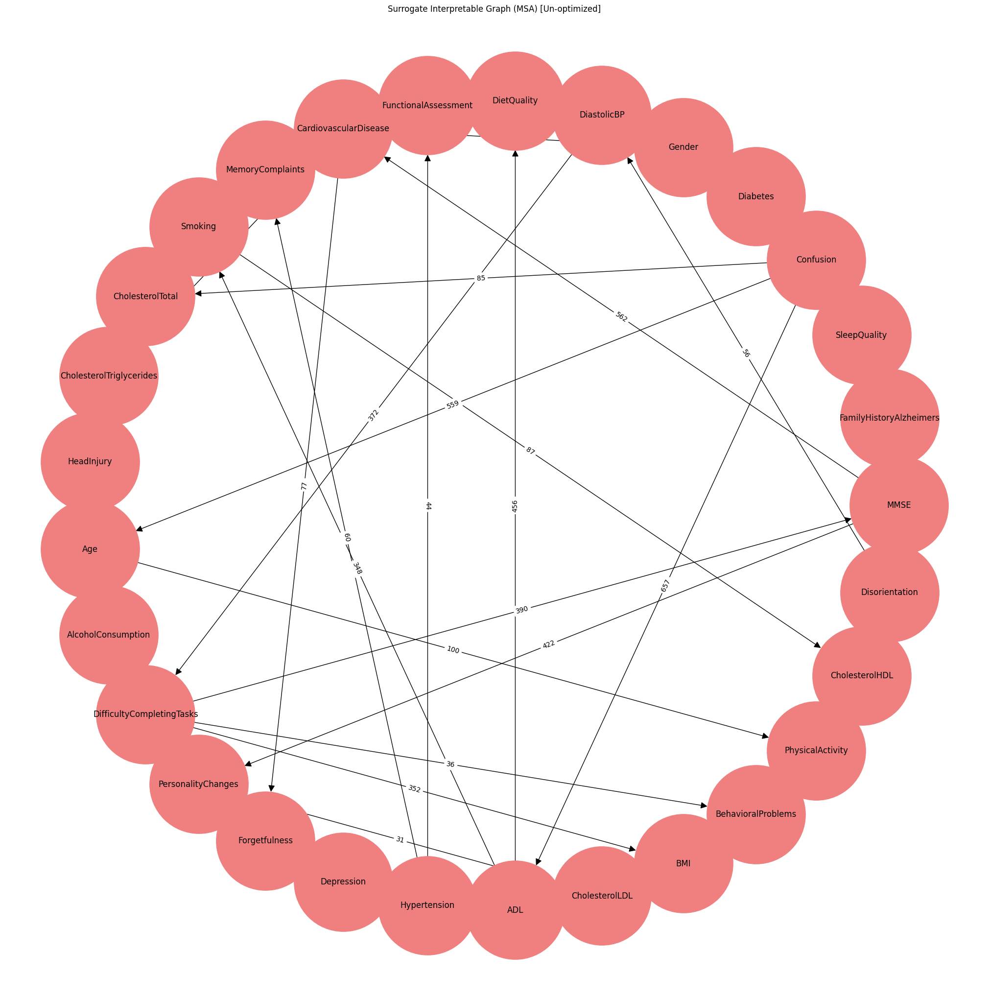

In [12]:
from sigRF.SIG import create_sig
sig = create_sig(columns=X.columns, encoded_rules=encoded_rules)

Welcome to the CBC MILP Solver 
Version: 2.10.3 
Build Date: Dec 15 2019 

command line - /Users/DubeyA-Dev/miniconda3/envs/taylor/lib/python3.10/site-packages/pulp/apis/../solverdir/cbc/osx/i64/cbc /var/folders/tk/qh_5gfz51996p7zxwjyl8r140000gp/T/f70c3bbdda184b9e893a5102897cf702-pulp.mps -max -timeMode elapsed -branch -printingOptions all -solution /var/folders/tk/qh_5gfz51996p7zxwjyl8r140000gp/T/f70c3bbdda184b9e893a5102897cf702-pulp.sol (default strategy 1)
At line 2 NAME          MODEL
At line 3 ROWS
At line 6 COLUMNS
At line 2755 RHS
At line 2757 BOUNDS
At line 3445 ENDATA
Problem MODEL has 1 rows, 687 columns and 687 elements
Coin0008I MODEL read with 0 errors
Option for timeMode changed from cpu to elapsed
Continuous objective value is 9293 - 0.00 seconds
Cgl0004I processed model has 1 rows, 668 columns (668 integer (649 of which binary)) and 668 elements
Cutoff increment increased from 1e-05 to 0.9999
Cbc0038I Initial state - 0 integers unsatisfied sum - 0
Cbc0038I Solution foun

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

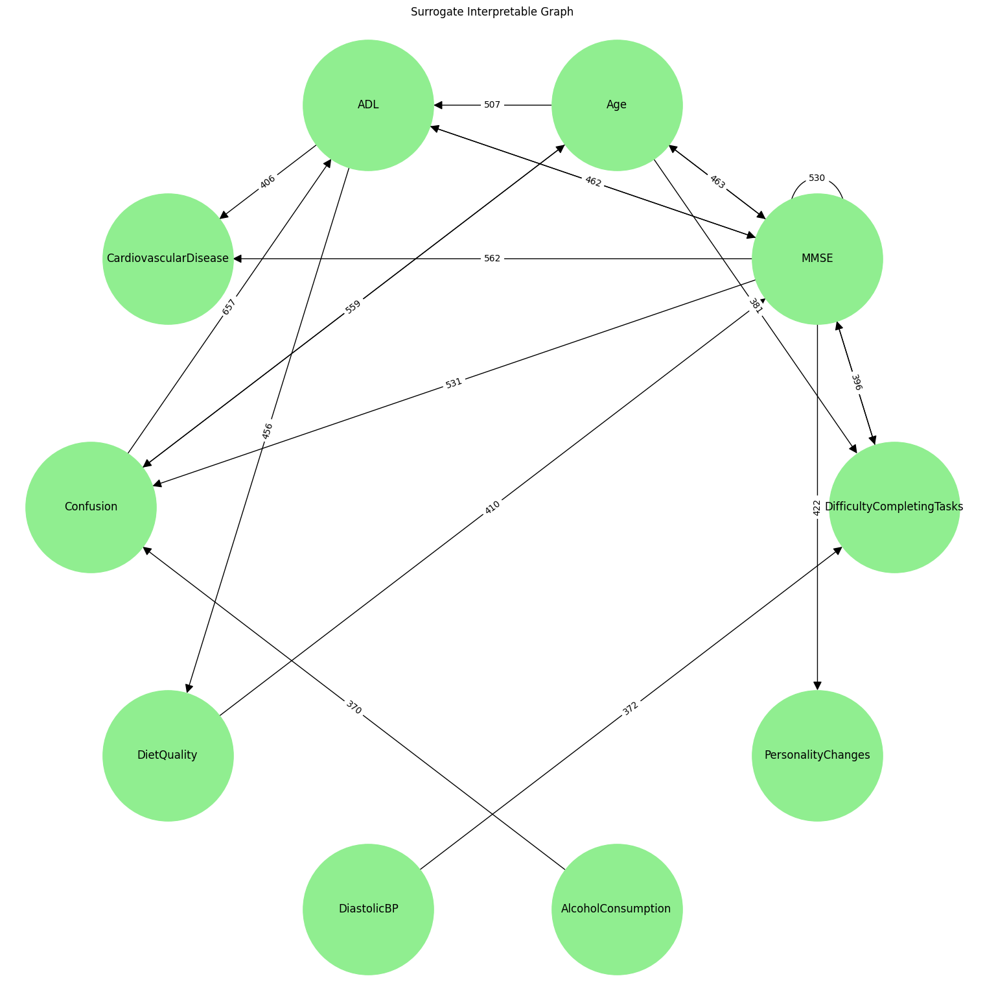

In [13]:
from sigRF.SIG import create_sig_optimized
sig_optimized  = create_sig_optimized(columns=X.columns, encoded_rules=encoded_rules)

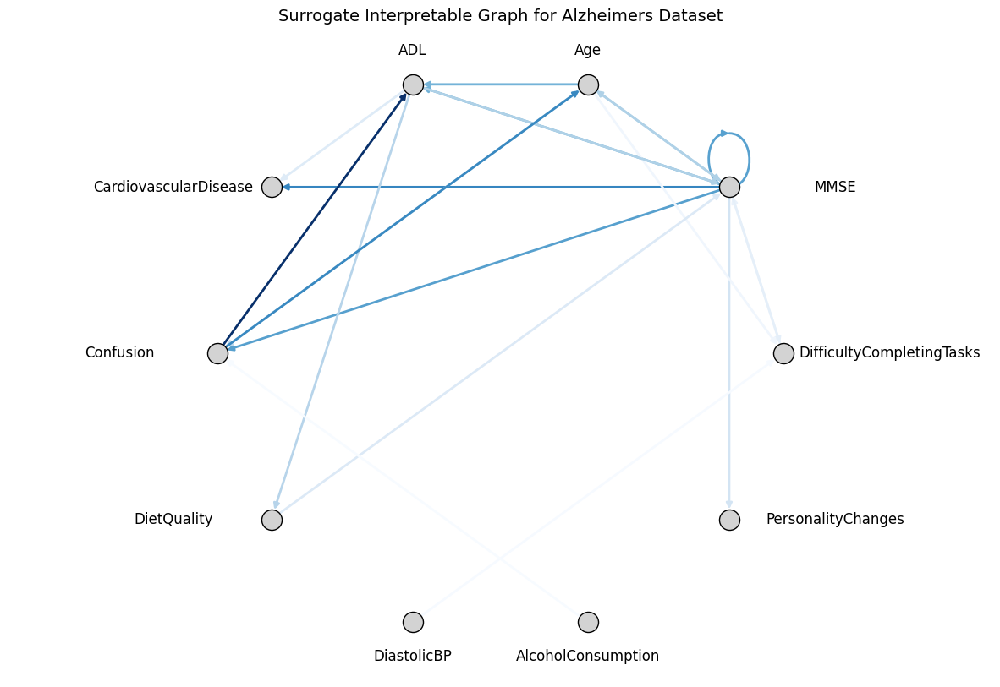

In [14]:
from sigRF.SIG import beautify
beautify(sig_optimized)